In [1]:
import pandas as pd
import numpy as np
from sklearn import datasets
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import normalize

In [2]:
#transpose matrix to have sample as row, gene in column
full_matrix_transpose = pd.read_csv(r"C:\Users\javte\Documents\SSEF project\datasets\full_matrix\matrix_logCPMrmBatch_20221207.csv", index_col=[0])
full_matrix = full_matrix_transpose.transpose()

In [3]:
#PCA
pca = PCA()
principalComponents_full_matrix = pca.fit_transform(full_matrix)
principal_full_matrix = pd.DataFrame(data = principalComponents_full_matrix
             , columns = ["PC"+str(i) for i in range(1, len(principalComponents_full_matrix)+1)])
principal_full_matrix.shape

(1190, 1190)

In [4]:
# Take pam50 column from metadata and set as index of PCA dataframe
unsorted_metadata = pd.read_csv(r"C:\Users\javte\Documents\SSEF project\datasets\Normalized expression data set\metadata\selected_metadat_20221128.csv")
full_matrix_pam50 = unsorted_metadata[('pam50')].to_list()
principal_full_matrix['pam50'] = full_matrix_pam50
principal_full_matrix.set_index('pam50', drop = True, inplace = True)

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

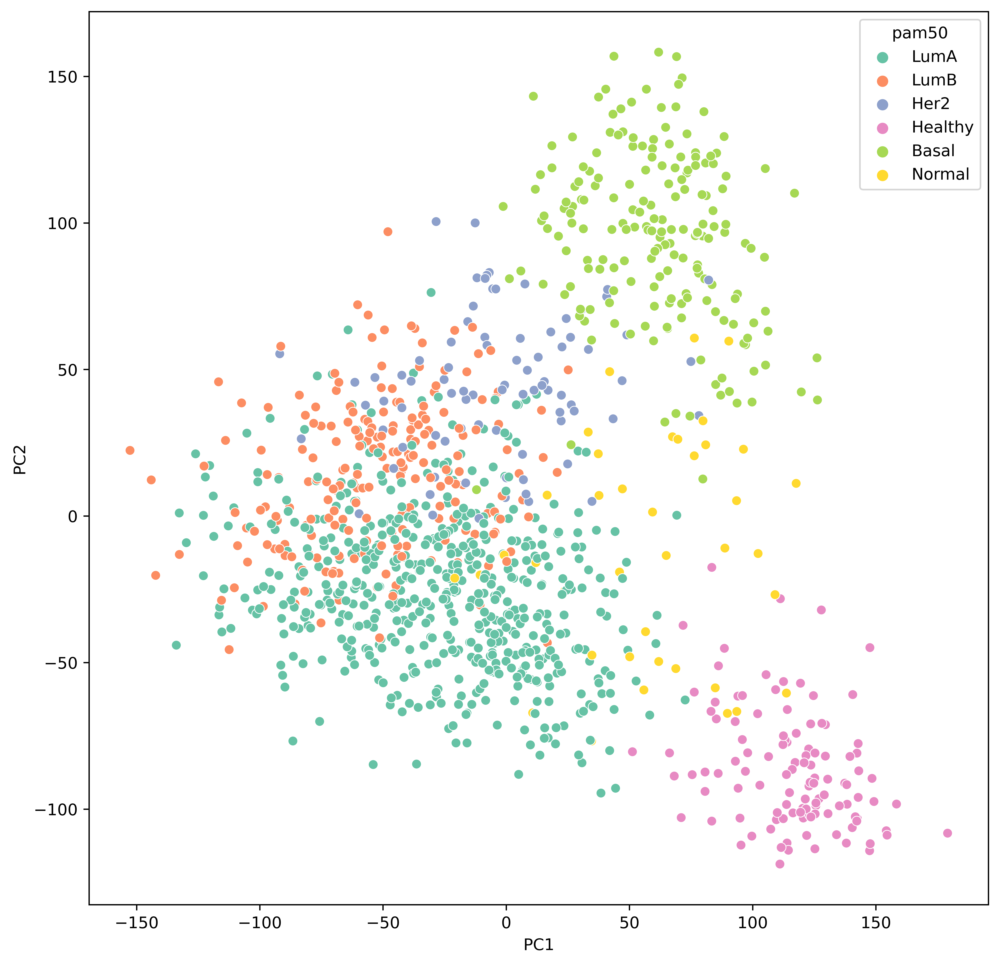

In [5]:
#formatting plot
fig,axes=plt.subplots(1,1,figsize=(10,10),dpi=800)
sns.scatterplot(ax=axes,x=principal_full_matrix['PC1'],y=principal_full_matrix['PC2'],hue=principal_full_matrix.index,palette='Set2')

Text(0, 0.5, 'explained variance (%)')

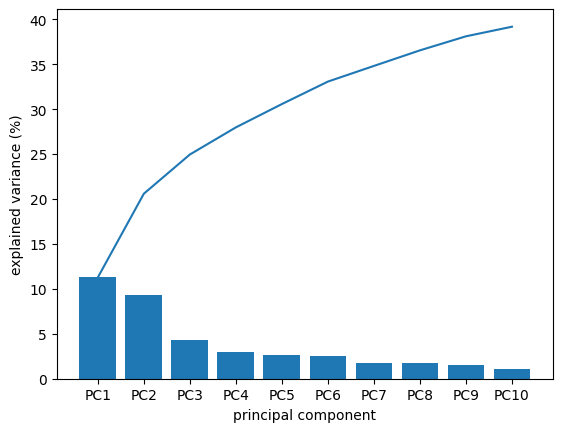

In [6]:
import matplotlib.pyplot as plt
#no. of PCs to be visualised
n = 10
#bar plot
plt.bar(x=principal_full_matrix.columns[:n], height = 100*pca.explained_variance_ratio_[:n])
#cumulative explained variance
cumulative = np.cumsum(100*pca.explained_variance_ratio_[:n])
plt.plot(principal_full_matrix.columns[:n], cumulative)
plt.xlabel('principal component')
plt.ylabel('explained variance (%)')

In [7]:
total=0;n=3
#cumulative explained variance for first n PCs
for var in pca.explained_variance_ratio_[:n]:
    total+= var
print(f'First {n} PC accounts for '+str('{0:.3g}'.format(100*total))+'% of variance')

First 3 PC accounts for 25% of variance


In [8]:
#PC1, PC2 to plot
pca_df = principal_full_matrix.iloc[:,0:2].reset_index()
del pca_df['pam50']
display(pca_df.head())

,PC1,PC2
0,-41.529531,-35.536286
1,-30.849645,-34.885648
2,-78.418226,19.854948
3,-0.647158,44.671889
4,120.544090,-103.044179


In [9]:
from sklearn.cluster import KMeans
from sklearn.model_selection import ParameterGrid
from sklearn import metrics

Parameter: {'n_clusters': 2} Silhouette Score 0.43904909256029856  Sum of squared distance 5313203.36609291
Parameter: {'n_clusters': 3} Silhouette Score 0.5163800810088368  Sum of squared distance 2675507.113998222
Parameter: {'n_clusters': 4} Silhouette Score 0.43746358913449884  Sum of squared distance 1823147.7717146692
Parameter: {'n_clusters': 5} Silhouette Score 0.4305903863485141  Sum of squared distance 1401738.938939477
Parameter: {'n_clusters': 6} Silhouette Score 0.3935958696680714  Sum of squared distance 1211289.8283551547
Parameter: {'n_clusters': 7} Silhouette Score 0.3766906642344608  Sum of squared distance 1046124.8690590528
Parameter: {'n_clusters': 8} Silhouette Score 0.3824318933407115  Sum of squared distance 917123.0439171946
Parameter: {'n_clusters': 12} Silhouette Score 0.36315083947757  Sum of squared distance 632733.1920784111
Parameter: {'n_clusters': 20} Silhouette Score 0.3485728485942334  Sum of squared distance 385255.2507703321
Parameter: {'n_clusters'

[Text(0.5, 0, 'Number of Clusters'), Text(0, 0.5, 'Sum of squared distance')]

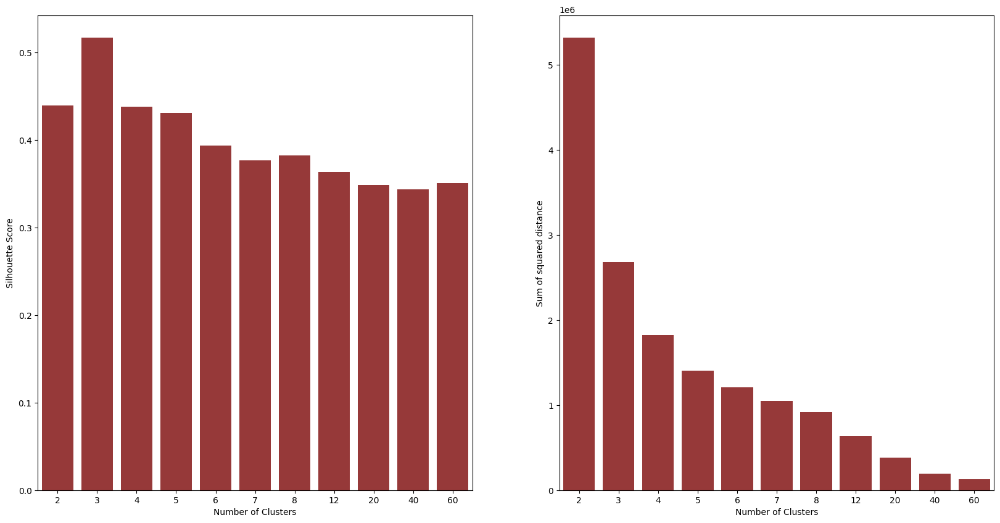

In [10]:
#values for number of cluster
parameters = [2, 3, 4, 5, 6, 7, 8, 12, 20, 40, 60]
parameter_grid = ParameterGrid({'n_clusters': parameters})
best_score = -1
kmeans_model = KMeans()     # instantiating KMeans model
silhouette_scores = []
inertia_scores = []
# evaluation based on silhouette_score
for p in parameter_grid:
    kmeans_model.set_params(**p)    # set current hyper parameter
    kmeans_model.fit(pca_df)        # fit model
    ss = metrics.silhouette_score(pca_df, kmeans_model.labels_)
    inertia = kmeans_model.inertia_
    # calculate silhouette_score
    silhouette_scores += [ss]    
    inertia_scores += [inertia] # store all the scores
    print('Parameter:', p, 'Silhouette Score', ss, ' Sum of squared distance', inertia)
    # check p which has the best score
    if ss > best_score:
        best_score = ss
        best_grid = p
# plotting silhouette score
fig, axes = plt.subplots(1,2, figsize=(20,10))
sns.barplot(ax=axes[0],x=list(parameters),y=silhouette_scores,color='brown')
axes[0].set(xlabel='Number of Clusters', ylabel='Silhouette Score')
sns.barplot(ax=axes[1],x=list(parameters),y=inertia_scores,color='brown')
axes[1].set(xlabel='Number of Clusters', ylabel='Sum of squared distance')

In [11]:
# fitting KMeans
kmeans_pca_3 = KMeans(n_clusters=3)
kmeans_pca_6 = KMeans(n_clusters=6)
kmeans_pca_8 = KMeans(n_clusters=8)

In [12]:
import matplotlib.pyplot as plt
#get kmeans clustering label
label_3 = kmeans_pca_3.fit_predict(pca_df)
label_6 = kmeans_pca_6.fit_predict(pca_df)
label_8 = kmeans_pca_8.fit_predict(pca_df)
to_conc = [pca_df,pd.Series(label_3),pd.Series(label_6),pd.Series(label_8)]
#join with PCA dataframes
pca_df_label = pd.concat(to_conc,axis=1)

In [13]:
#assign column names
pca_df_label.columns=['PC1','PC2','label_3','label_6','label_8']
pca_df_label.head()

,PC1,PC2,label_3,label_6,label_8
0,-41.529531,-35.536286,0,3,0
1,-30.849645,-34.885648,0,3,0
2,-78.418226,19.854948,0,5,4
3,-0.647158,44.671889,1,0,3
4,120.544090,-103.044179,2,1,2


In [14]:
fig,axes=plt.subplots(1,3,figsize=(24,6),dpi=800)
sns.scatterplot(ax=axes[0],x=pca_df_label['PC1'],y=pca_df_label['PC2'],hue=pca_df_label['label_3'],palette='Set2')
sns.scatterplot(ax=axes[1],x=pca_df_label['PC1'],y=pca_df_label['PC2'],hue=pca_df_label['label_6'],palette='Set2')
sns.scatterplot(ax=axes[2],x=pca_df_label['PC1'],y=pca_df_label['PC2'],hue=pca_df_label['label_8'],palette='Set2')

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

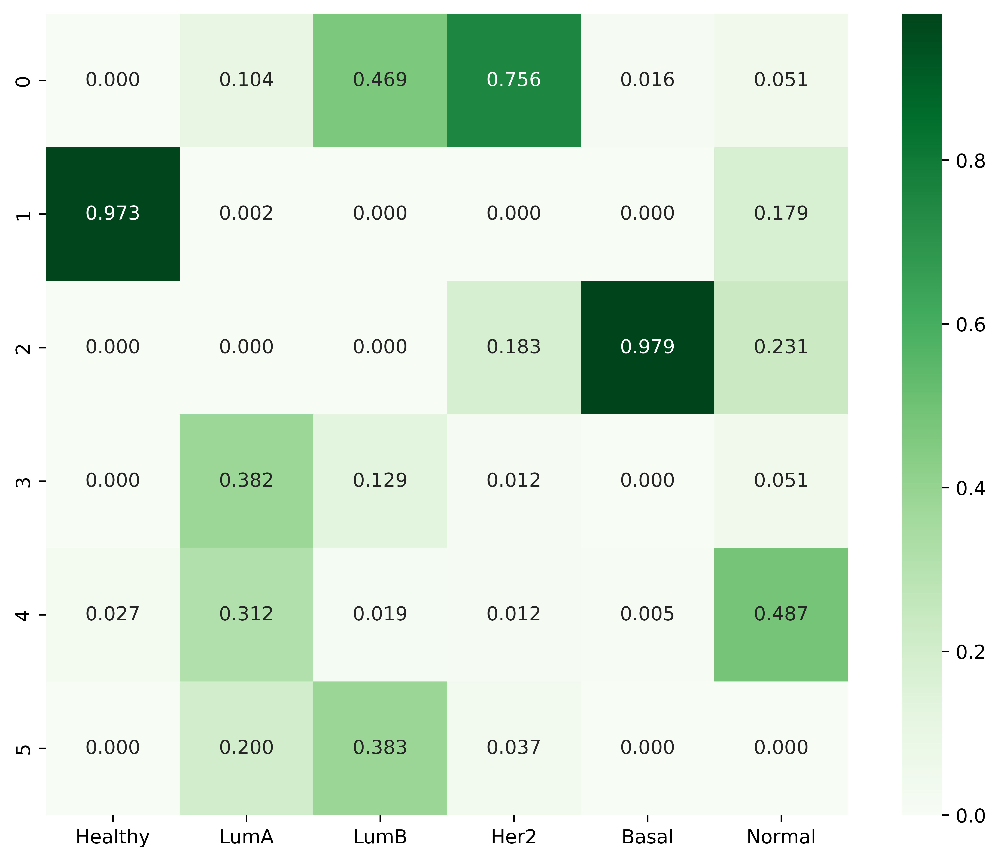

In [15]:
df = pd.DataFrame(zip(full_matrix_pam50,pca_df_label['label_6']),columns=['pam50','label_6'])
confusion_matrix = pd.crosstab(df['label_6'], df['pam50'], rownames=['label_6'], colnames=['pam50'])
confusion_matrix = confusion_matrix[['Healthy','LumA','LumB','Her2','Basal','Normal']]
confusion_matrix_normed = pd.DataFrame(normalize(confusion_matrix, axis=0, norm='l1'),columns=['Healthy','LumA','LumB','Her2','Basal','Normal'])
fig,axes=plt.subplots(1,1,figsize=(10,7.5),dpi=800)
sns.heatmap(confusion_matrix_normed, annot=True,square=True,ax=axes,fmt='.3f',cmap='Greens')
plt.show()

In [16]:
pca_df

,PC1,PC2
0,-41.529531,-35.536286
1,-30.849645,-34.885648
2,-78.418226,19.854948
3,-0.647158,44.671889
4,120.544090,-103.044179
...,...,...
1185,1.035255,13.323431
1186,18.555666,118.795795
1187,7.798277,-10.379151
1188,14.265547,-23.708248


In [17]:
import umap
reducer = umap.UMAP(random_state=77)
#create df to apply umap to 
umap_input = full_matrix
#apply umap
reducer.fit(umap_input)

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


UMAP(random_state=77, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

In [18]:
embedding = reducer.transform(umap_input)
assert(np.all(embedding == reducer.embedding_))
embedding.shape

(1190, 2)

In [19]:
umap_df=pd.DataFrame(embedding,columns=['UMAP_1','UMAP_2'])

<AxesSubplot: xlabel='UMAP_1', ylabel='UMAP_2'>

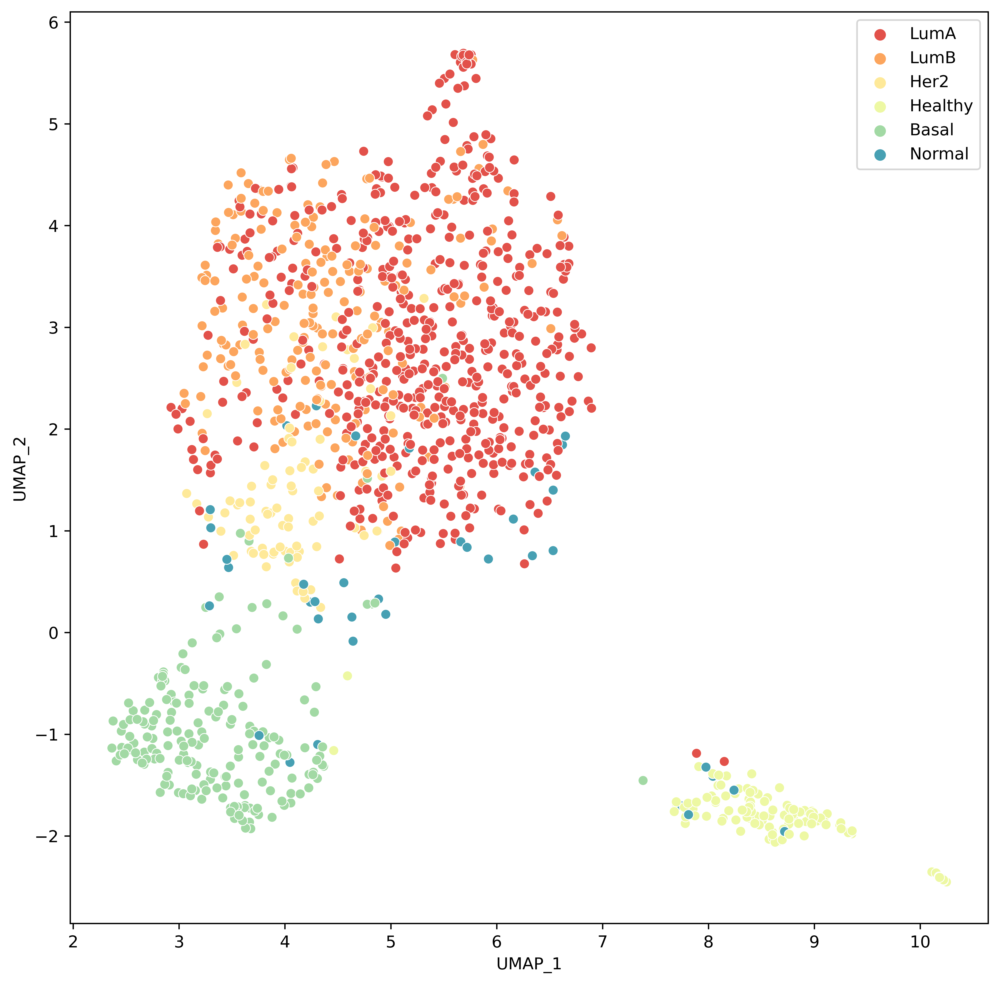

In [20]:
fig,axes=plt.subplots(1,1,figsize=(10,10),dpi=800)
sns.scatterplot(x=umap_df['UMAP_1'],y=umap_df['UMAP_2'],hue=full_matrix_pam50,palette='Spectral')

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 2} Score 0.5323326


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 3} Score 0.572877


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 4} Score 0.4458335


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 5} Score 0.4477145


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 6} Score 0.45500284


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 7} Score 0.4405677


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 8} Score 0.4364419


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 12} Score 0.40027323


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 20} Score 0.38320646


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 40} Score 0.3824332


C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Parameter: {'n_clusters': 60} Score 0.3861918


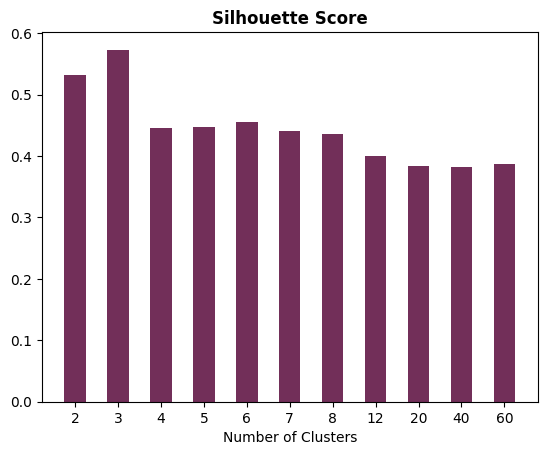

In [21]:
# candidate values for our number of cluster
parameters = [2, 3, 4, 5, 6, 7, 8, 12, 20, 40, 60]
# instantiating ParameterGrid, pass number of clusters as input
parameter_grid = ParameterGrid({'n_clusters': parameters})
best_score = -1
kmeans_model = KMeans()     # instantiating KMeans model
silhouette_scores = []
# evaluation based on silhouette_score
for p in parameter_grid:
    kmeans_model.set_params(**p)    # set current hyper parameter
    kmeans_model.fit(umap_df)          # fit model
    ss = metrics.silhouette_score(umap_df, kmeans_model.labels_)   # calculate silhouette_score
    silhouette_scores += [ss]       # store all the scores
    print('Parameter:', p, 'Score', ss)
    # check p which has the best score
    if ss > best_score:
        best_score = ss
        best_grid = p
# plotting silhouette score
plt.bar(range(len(silhouette_scores)), list(silhouette_scores), align='center', color='#722f59', width=0.5)
plt.xticks(range(len(silhouette_scores)), list(parameters))
plt.title('Silhouette Score', fontweight='bold')
plt.xlabel('Number of Clusters')
plt.show()

In [22]:
# fitting KMeans
kmeans_umap_3 = KMeans(n_clusters=3)
kmeans_umap_6 = KMeans(n_clusters=6)
kmeans_umap_8 = KMeans(n_clusters=8)

In [23]:
label_umap_3 = kmeans_umap_3.fit_predict(umap_df)
label_umap_6 = kmeans_umap_6.fit_predict(umap_df)
label_umap_8 = kmeans_umap_8.fit_predict(umap_df)
to_conc = [umap_df,pd.Series(label_umap_3),pd.Series(label_umap_6),pd.Series(label_umap_8)]
umap_labels = pd.concat(to_conc,axis=1)
umap_labels.columns=['UMAP_1','UMAP_2','label_3','label_6','label_8']

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [24]:
fig,axes=plt.subplots(1,3,figsize=(24,6),dpi=800)
sns.scatterplot(ax=axes[0],x=umap_labels['UMAP_1'],y=umap_labels['UMAP_2'],hue=umap_labels['label_3'],palette='Set2')
sns.scatterplot(ax=axes[1],x=umap_labels['UMAP_1'],y=umap_labels['UMAP_2'],hue=umap_labels['label_6'],palette='Set2')
sns.scatterplot(ax=axes[2],x=umap_labels['UMAP_1'],y=umap_labels['UMAP_2'],hue=umap_labels['label_8'],palette='Set2')

<AxesSubplot: xlabel='UMAP_1', ylabel='UMAP_2'>

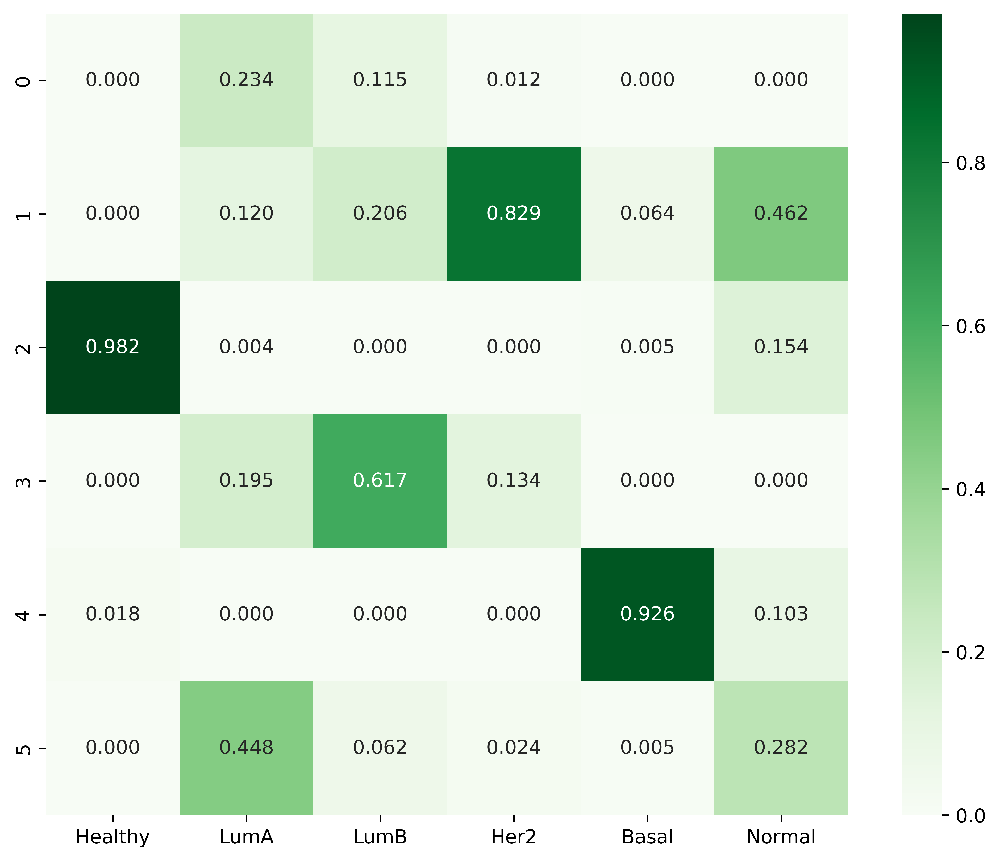

In [33]:
df = pd.DataFrame(zip(full_matrix_pam50,umap_labels['label_6']),columns=['pam50','label_6'])
confusion_matrix = pd.crosstab(df['label_6'], df['pam50'], rownames=['label_6'], colnames=['pam50'])
confusion_matrix = confusion_matrix[['Healthy','LumA','LumB','Her2','Basal','Normal']]
confusion_matrix_normed = pd.DataFrame(normalize(confusion_matrix, axis=0, norm='l1'),columns=['Healthy','LumA','LumB','Her2','Basal','Normal'])
fig,axes=plt.subplots(1,1,figsize=(10,7.5),dpi=800)
sns.heatmap(confusion_matrix_normed, annot=True,square=True,ax=axes,fmt='.3f',cmap='Greens')
plt.show()

In [1]:
#hierarchal clustering
from scipy.cluster.hierarchy import fcluster, linkage
distance_matrix = linkage(full_matrix, method = 'ward', metric = 'euclidean')
# Import the dendrogram function
from scipy.cluster.hierarchy import dendrogram
# Create a dendrogram
fig,axes=plt.subplots(1,1,figsize=(16,8))
dn = dendrogram(distance_matrix,p=30,truncate_mode='level')
plt.show()

NameError: name 'full_matrix' is not defined

In [27]:
hierarchal_labels_3 = fcluster(distance_matrix, 3, criterion='maxclust')
hierarchal_labels_6 = fcluster(distance_matrix, 6, criterion='maxclust')
display(hierarchal_labels_3);display(hierarchal_labels_6)

array([1, 1, 1, ..., 1, 1, 2], dtype=int32)

array([1, 3, 1, ..., 3, 3, 5], dtype=int32)

In [28]:
import seaborn as sns
fig, axes = plt.subplots(1, 3, figsize=(24,6),dpi=800)
sns.scatterplot(ax=axes[0], x=pca_df['PC1'],y=pca_df['PC2'], hue=hierarchal_labels_3, legend= 'full',palette='Set2')
sns.scatterplot(ax=axes[1], x=pca_df['PC1'],y=pca_df['PC2'], hue=hierarchal_labels_6, legend= 'full',palette='Spectral')
sns.scatterplot(ax=axes[2], x=pca_df['PC1'],y=pca_df['PC2'], hue=full_matrix_pam50, legend= 'full',palette='Spectral')

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

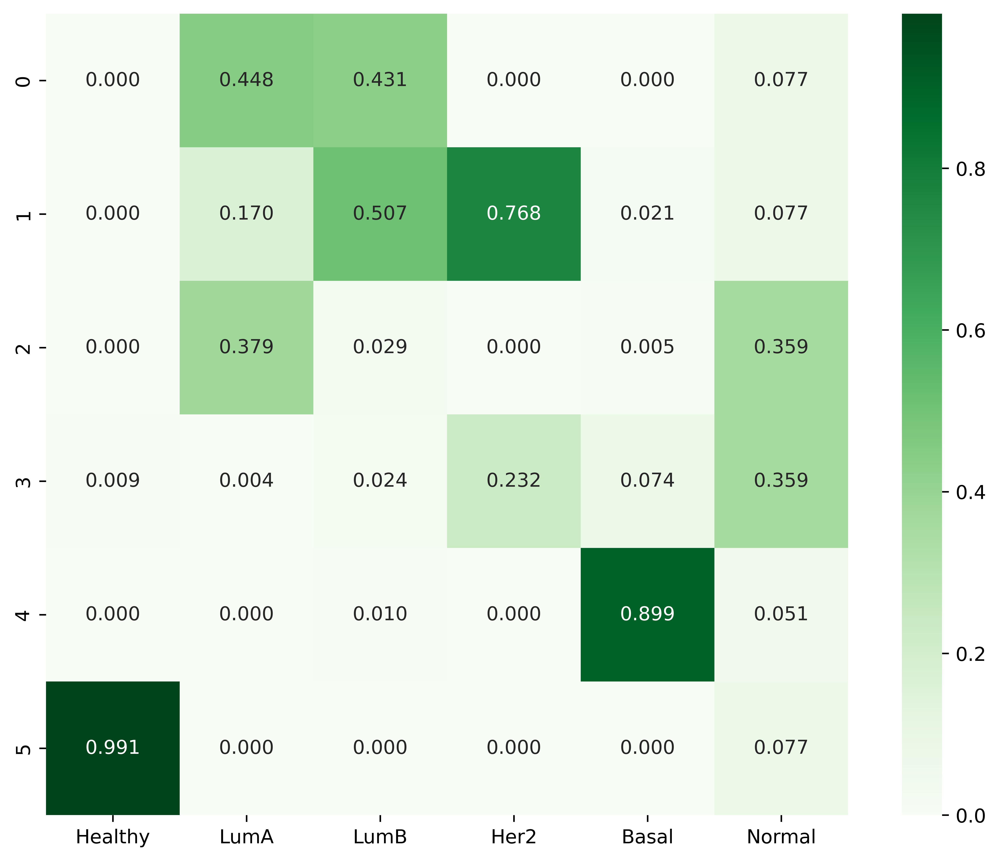

In [29]:
df = pd.DataFrame(zip(full_matrix_pam50,hierarchal_labels_6),columns=['pam50','label_6'])
confusion_matrix = pd.crosstab(df['label_6'], df['pam50'], rownames=['label_6'], colnames=['pam50'])
confusion_matrix = confusion_matrix[['Healthy','LumA','LumB','Her2','Basal','Normal']]
confusion_matrix_normed = pd.DataFrame(normalize(confusion_matrix, axis=0, norm='l1'),columns=['Healthy','LumA','LumB','Her2','Basal','Normal'])
fig,axes=plt.subplots(1,1,figsize=(10,7.5),dpi=800)
sns.heatmap(confusion_matrix_normed, annot=True,square=True,ax=axes,fmt='.3f',cmap='Greens')
plt.show()